# Dataset Exploration

In this jupyter notebook I will explore the dataset.

## Setting seeds and globals

In [1]:
import os
import random
import numpy as np
import pandas as pd
import tensorflow as tf
import keras
import matplotlib

%matplotlib inline

Using TensorFlow backend.


In [2]:
os.environ['PYTHONHASHSEED'] = '0'

# setting the seed for numpy
np.random.seed(2108)

# setting the seed for python random numbers
random.seed(2108)

# setting the seed for tensorflow
tf.set_random_seed(2108)

from keras import backend as K

# Force tensorflow to use a single thread
session_conf = tf.ConfigProto(intra_op_parallelism_threads=1, inter_op_parallelism_threads=1)
sess = tf.Session(graph = tf.get_default_graph(), config=session_conf)
K.set_session(sess)

In [3]:
print(os.listdir("input"))

['sample_submission.csv', 'test', 'train', 'train_labels.csv', 'validation']


In [4]:
TRAIN_DIR = "input/train"
VALIDATION_DIR = "input/validation"
TEST_DIR = "input/test"

## Exploring the dataset

In this section I will explore the dataset, I will look out for:


1.   Train Labels
2.   Balance in the dataset
3.   Original Image Visualization
4.   Applying some filters and Visualizing the images
5.   Applying thresholding

In [5]:
df = pd.read_csv("input/train_labels.csv")
print(df.head())
print(df.tail())

   name  invasive
0     1         0
1     2         0
2     3         1
3     4         0
4     5         1
      name  invasive
2290  2291         1
2291  2292         1
2292  2293         1
2293  2294         1
2294  2295         1


In [6]:
print(df.groupby(['invasive']).size())

invasive
0     847
1    1448
dtype: int64


The dataset looks quite balanced.

### Simple Visualizations

In [7]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimage
import cv2

In [8]:
df = pd.read_csv('input/train_labels.csv')

In [9]:
# refered from https://stackoverflow.com/questions/19471814/display-multiple-images-in-one-ipython-notebook-cell
def sample_visual(n, path):
    images = random.sample(os.listdir(path), n)
    plt.figure(figsize=(20,10))
    columns = 5
    for i,img in enumerate(images):
        image = mpimage.imread(path + '/' + img)
        plt.subplot(len(images) / columns + 1, columns, i + 1)
        plt.title(img)
        plt.imshow(image)

We will now see some of invasive samples

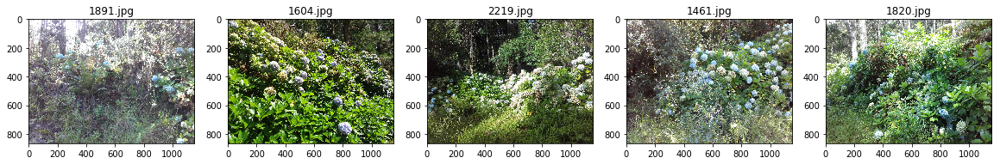

In [10]:
sample_visual(5, os.path.join(TRAIN_DIR, 'invasive'))

Now we will examine some of non-invasive samples

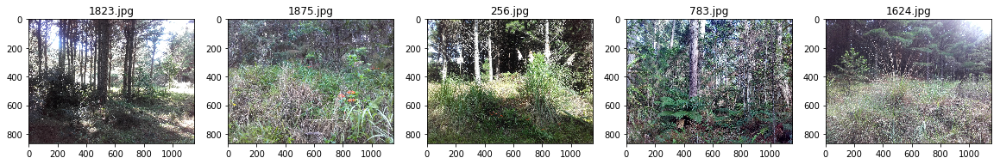

In [11]:
sample_visual(5, os.path.join(TRAIN_DIR, 'non-invasive'))

We will now apply transformations on the images to see if transformations bring out any further details

In [12]:
# referred from https://www.kaggle.com/netzone/visualization-using-cv2-and-keras-starter
def sample_visual_with_transformation(n, path):
    images = random.sample(os.listdir(path), n)
    for img in images:
        full_img_path = path + '/' + img
        ori_smpl = cv2.imread(full_img_path)
        smpl_1_rgb = cv2.cvtColor(cv2.imread(full_img_path), cv2.COLOR_BGR2RGB)
        smpl_1_lab = cv2.cvtColor(cv2.imread(full_img_path), cv2.COLOR_BGR2LAB)
        smpl_1_gray =  cv2.cvtColor(cv2.imread(full_img_path), cv2.COLOR_BGR2GRAY) 
        print(img)
        f, ax = plt.subplots(1, 4,figsize=(30,20))
        (ax1, ax2, ax3, ax4) = ax.flatten()
        ax1.set_title("Original - BGR")
        ax1.imshow(ori_smpl)
        ax2.set_title("Transformed - RGB")
        ax2.imshow(smpl_1_rgb)
        ax3.set_title("Transformed - LAB")
        ax3.imshow(smpl_1_lab)
        ax4.set_title("Transformed - GRAY")
        ax4.imshow(smpl_1_gray)
        plt.show()

2284.jpg


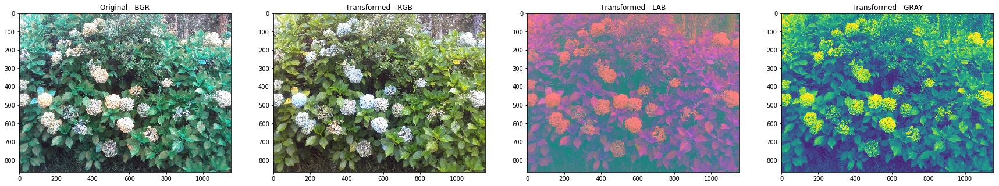

301.jpg


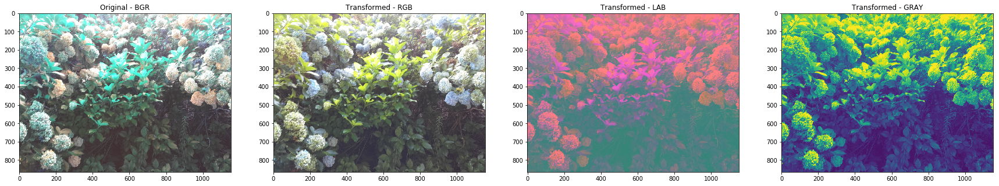

464.jpg


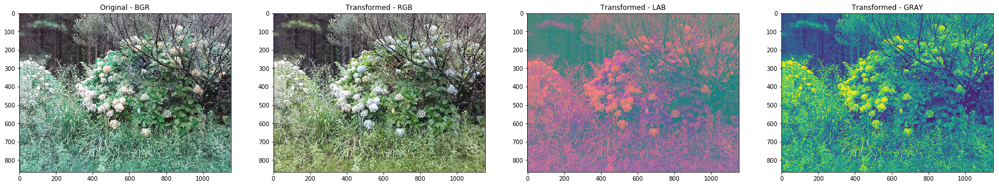

1914.jpg


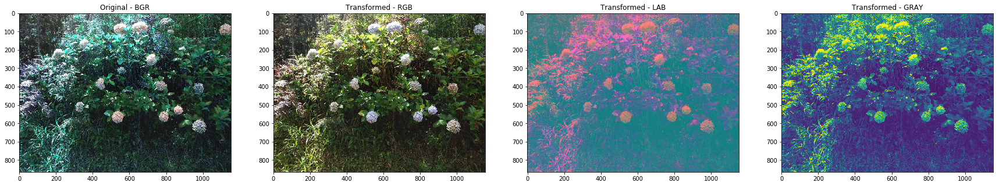

1474.jpg


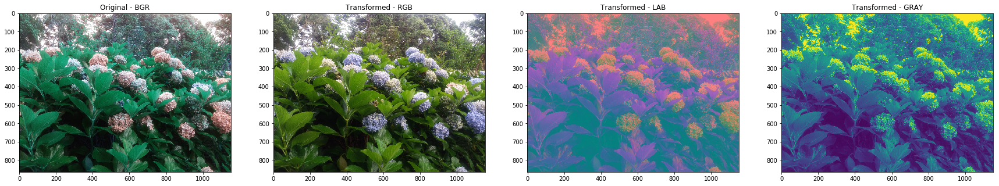

In [13]:
sample_visual_with_transformation(5, os.path.join(TRAIN_DIR, 'invasive'))

251.jpg


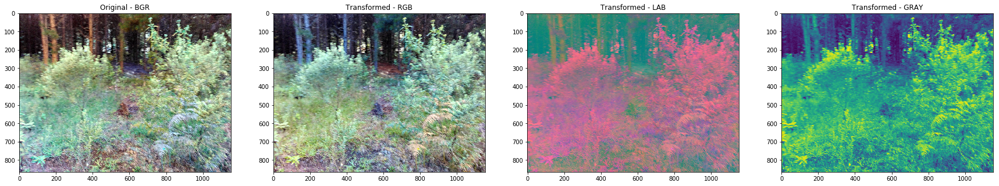

1296.jpg


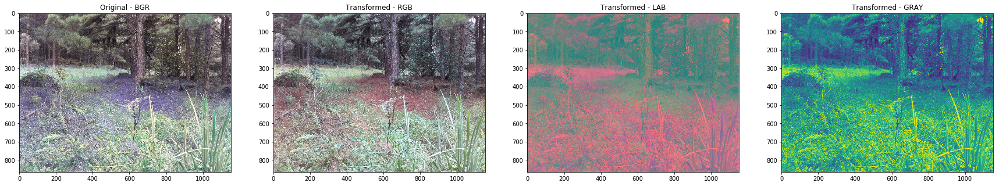

1218.jpg


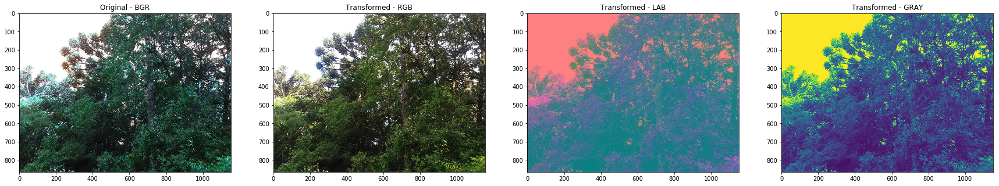

2218.jpg


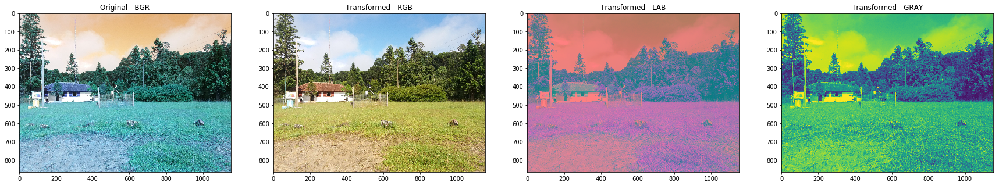

1710.jpg


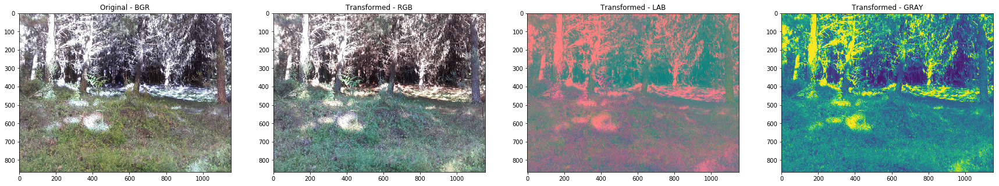

In [14]:
sample_visual_with_transformation(5, os.path.join(TRAIN_DIR, 'non-invasive'))

We can clearly see that an invasive hydrangea has some flower like structure, let us if applying thresholding we can bring out the details.

In [15]:
# referred from https://docs.opencv.org/3.4.1/d7/d4d/tutorial_py_thresholding.html
def sample_visual_with_thresholding(n, path):
    images = random.sample(os.listdir(path), n)
    for img in images:
        full_img_path = path + '/' + img
        orig_sample = cv2.imread(full_img_path,0)
        image = cv2.medianBlur(orig_sample,5)
        ret, global_threshold = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
        adaptive_mean_threshold = cv2.adaptiveThreshold(image, 255, 
                                                        cv2.ADAPTIVE_THRESH_MEAN_C, 
                                                        cv2.THRESH_BINARY,11,2)
        adaptive_gaussian_threshold = cv2.adaptiveThreshold(image, 255, 
                                                             cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                                             cv2.THRESH_BINARY,11,2)
        print(img)
        f, ax = plt.subplots(1, 4,figsize=(30,20))
        (ax1, ax2, ax3, ax4) = ax.flatten()
        ax1.set_title("'Original Image")
        ax1.imshow(orig_sample)
        ax2.set_title("Global Thresholding (v = 127)")
        ax2.imshow(global_threshold, 'gray')
        ax3.set_title("Adaptive Mean Thresholding")
        ax3.imshow(adaptive_mean_threshold, 'gray')
        ax4.set_title("Adaptive Gaussian Thresholding")
        ax4.imshow(adaptive_gaussian_threshold, 'gray')
        plt.show()

1720.jpg


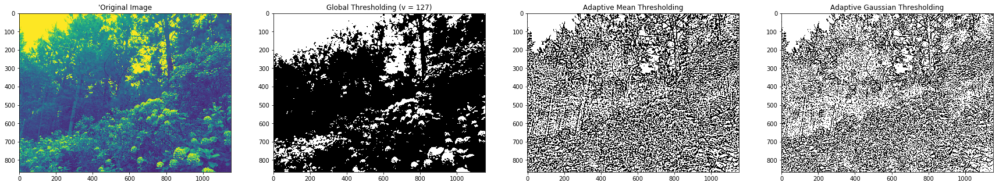

1190.jpg


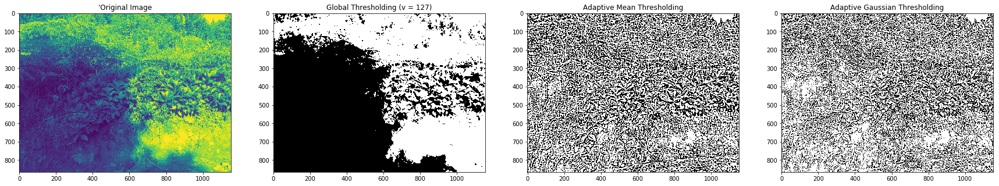

1398.jpg


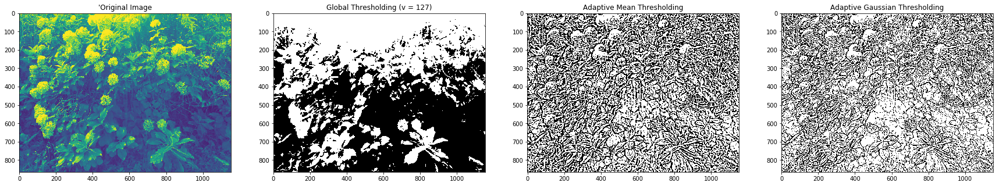

30.jpg


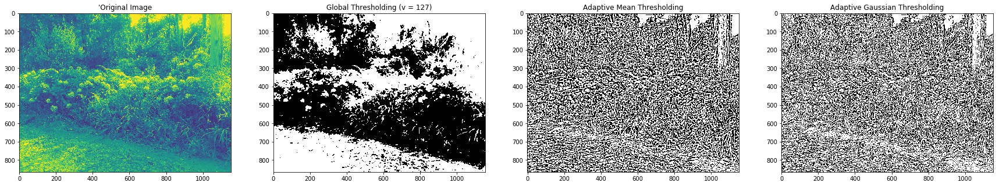

1286.jpg


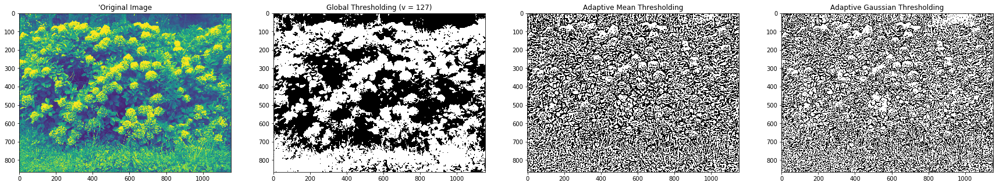

In [16]:
sample_visual_with_thresholding(5, os.path.join(TRAIN_DIR, 'invasive'))

645.jpg


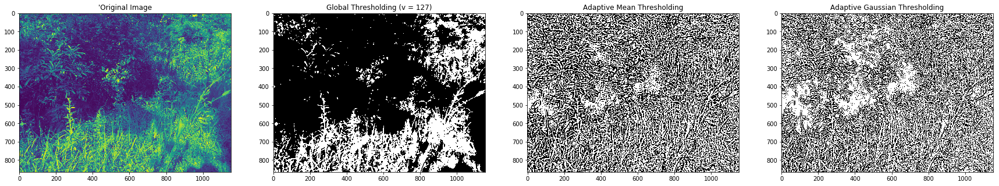

890.jpg


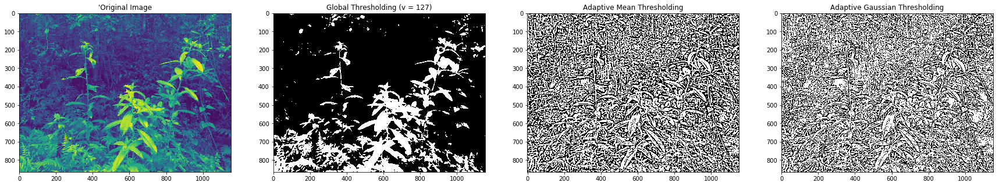

704.jpg


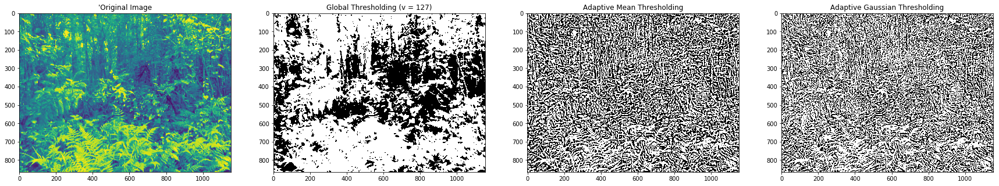

1280.jpg


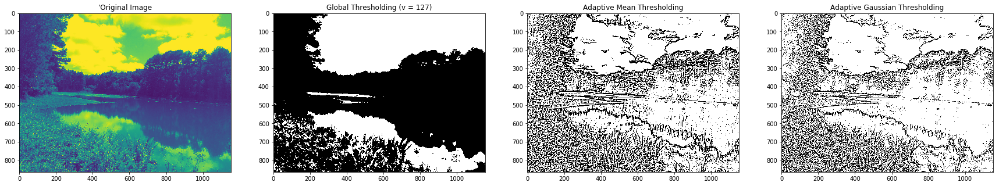

251.jpg


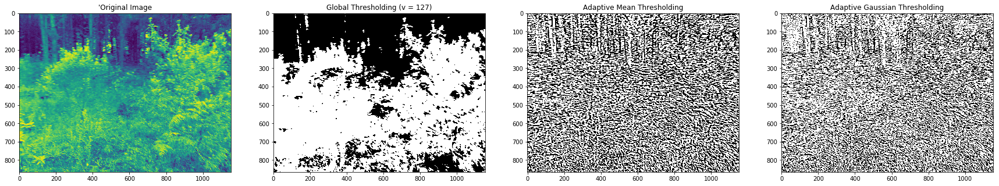

In [17]:
sample_visual_with_thresholding(5, os.path.join(TRAIN_DIR, 'non-invasive'))

In [18]:
# referred from https://docs.opencv.org/3.4.1/d7/d4d/tutorial_py_thresholding.html
def sample_visual_with_otsu(n, path):
    images = random.sample(os.listdir(path), n)
    for img in images:
        full_img_path = path + '/' + img
        orig_sample = cv2.imread(full_img_path,0)
        image = orig_sample
        # global thresholding
        ret1,th1 = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
        
        # Otsu's thresholding
        ret2,th2 = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        
        # Otsu's thresholding after Gaussian filtering
        blur = cv2.GaussianBlur(image, (5, 5), 0)
        ret3, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        
        # plot all the images and their histograms
        images_list = [image, 0, th1,
                      image, 0, th2,
                      blur, 0, th3]
        titles = ['Original Noisy Image','Histogram','Global Thresholding (v=127)',
                  'Original Noisy Image','Histogram',"Otsu's Thresholding",
                  'Gaussian filtered Image','Histogram',"Otsu's Thresholding"]
        print(img)
        plt.figure(figsize=(20,10))
        for i in range(3):
            plt.subplot(3,3,i*3+1), plt.imshow(images_list[i*3], 'gray')
            plt.title(titles[i*3]), plt.xticks([]), plt.yticks([])
            
            plt.subplot(3,3,i*3+2),plt.hist(images_list[i*3].ravel(),256)
            plt.title(titles[i*3+1]), plt.xticks([]), plt.yticks([])
            
            plt.subplot(3,3,i*3+3),plt.imshow(images_list[i*3+2],'gray')
            plt.title(titles[i*3+2]), plt.xticks([]), plt.yticks([])
        plt.show()

1990.jpg


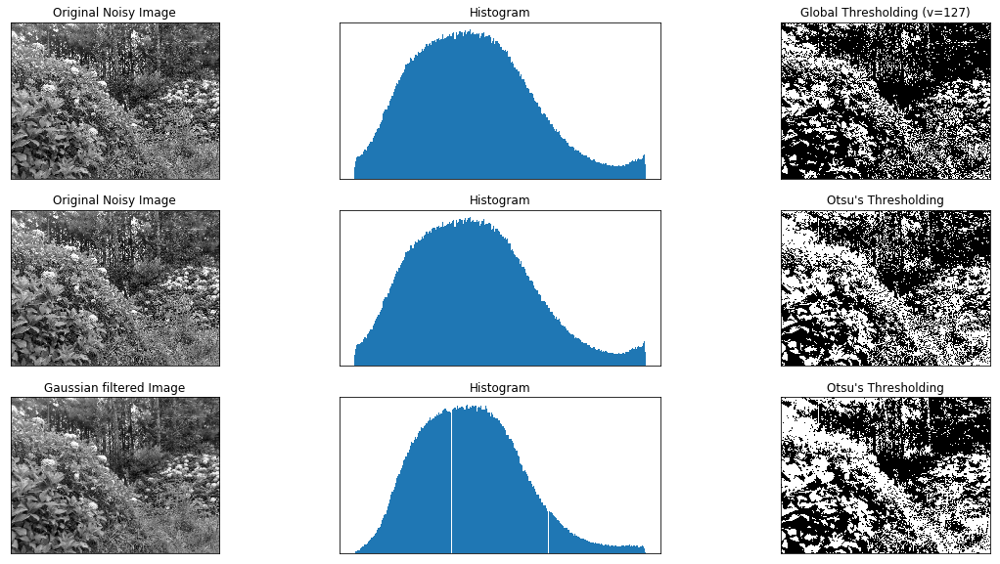

555.jpg


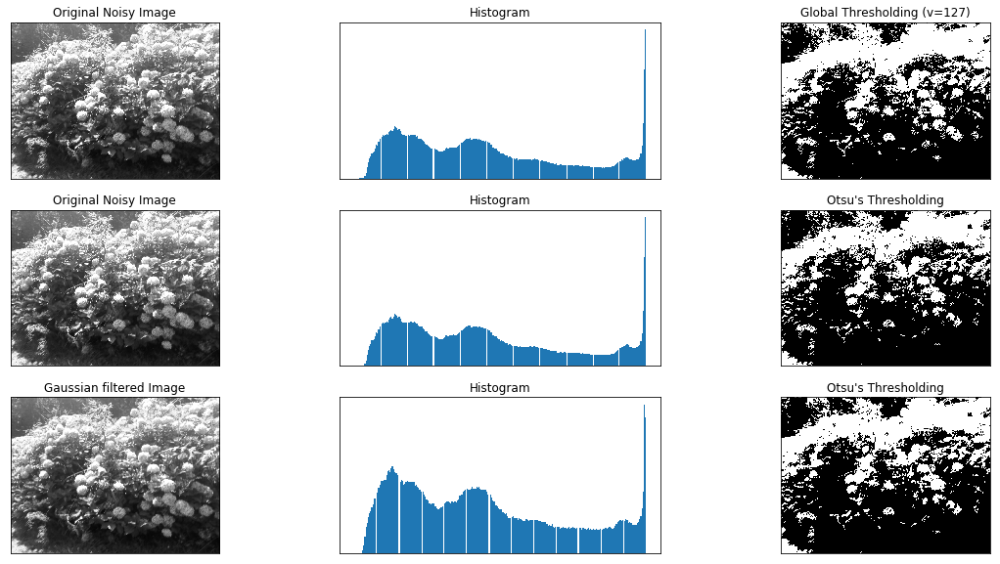

40.jpg


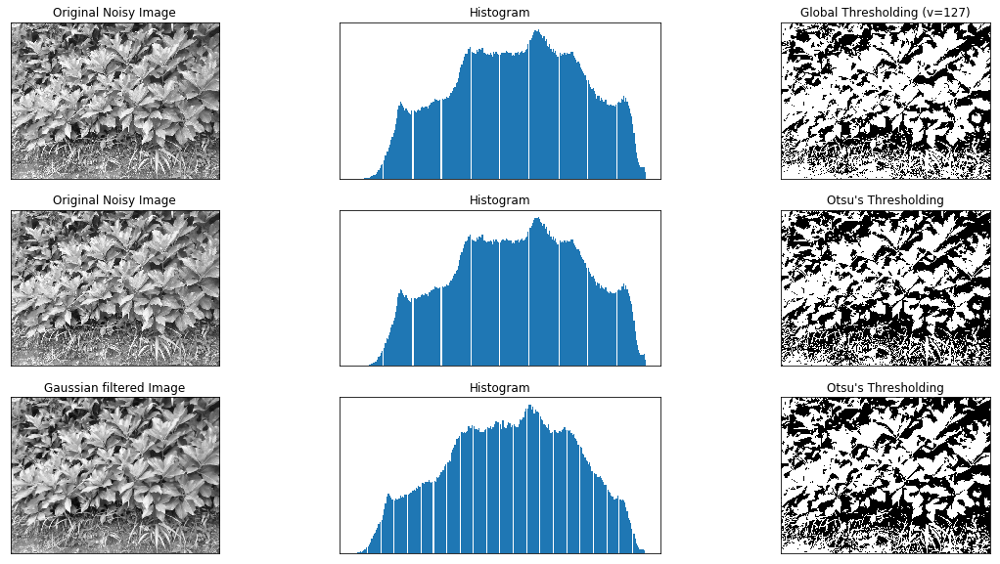

In [19]:
sample_visual_with_otsu(3, os.path.join(TRAIN_DIR, 'invasive'))

1596.jpg


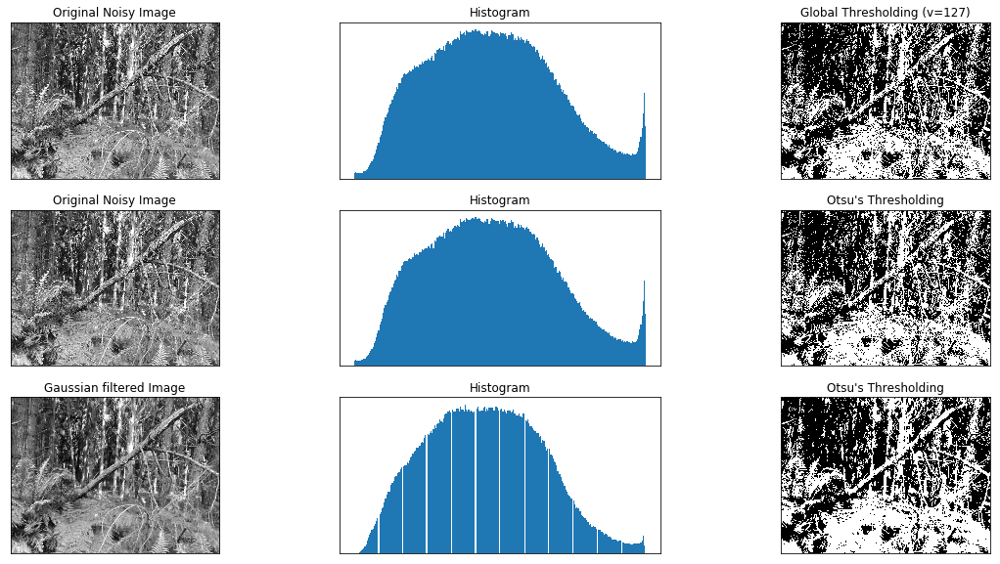

843.jpg


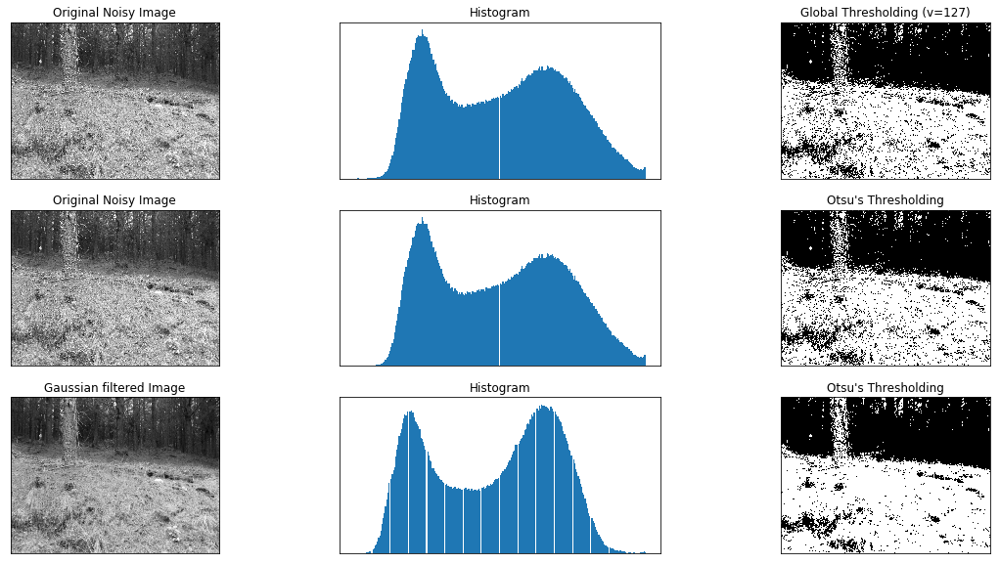

1763.jpg


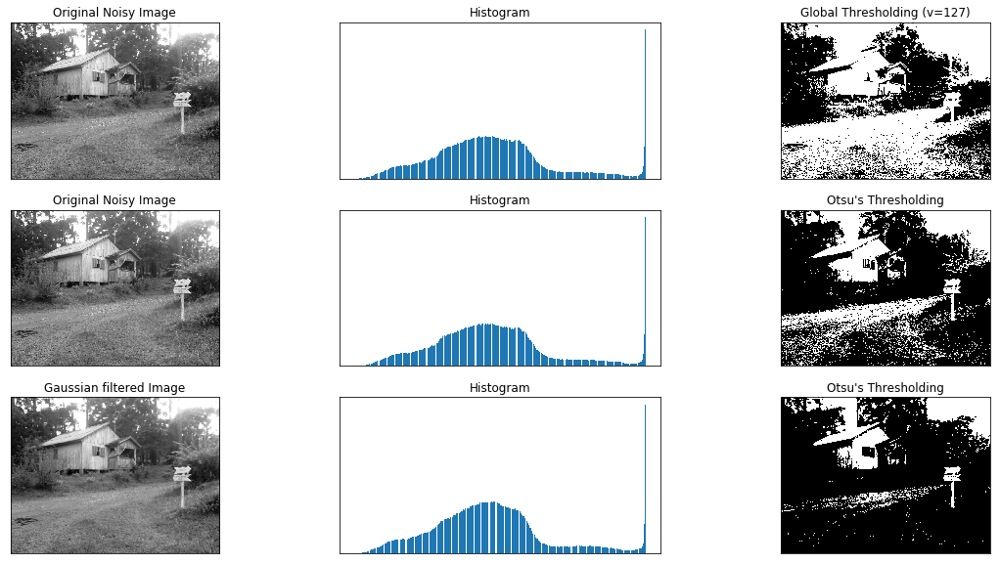

In [116]:
sample_visual_with_otsu(3, os.path.join(TRAIN_DIR, 'non-invasive'))

Clearly, the thresholding reveals that in invasive there are characteristic histograms. Now we will train some models and try to give predictions.

In [27]:
def sample_visual_resized(n, path, size):
    images = random.sample(os.listdir(path), n)
    plt.figure(figsize=(15,15))
    columns = 2
    for i,img in enumerate(images):
        image = cv2.imread(path + '/' + img)
        image = cv2.resize(image, (size,size))
        plt.subplot(len(images) / columns + 1, columns, i + 1)
        plt.title(img)
        plt.imshow(image)

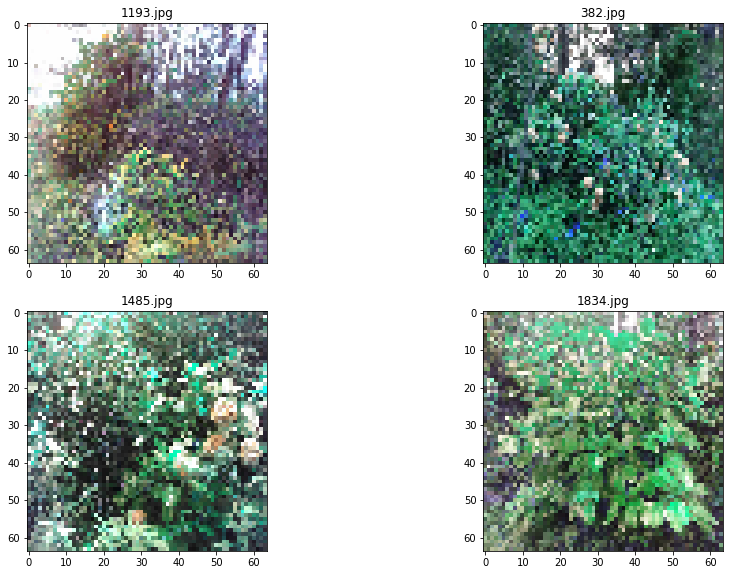

In [28]:
sample_visual_resized(4, os.path.join(TRAIN_DIR, 'invasive'), 64)

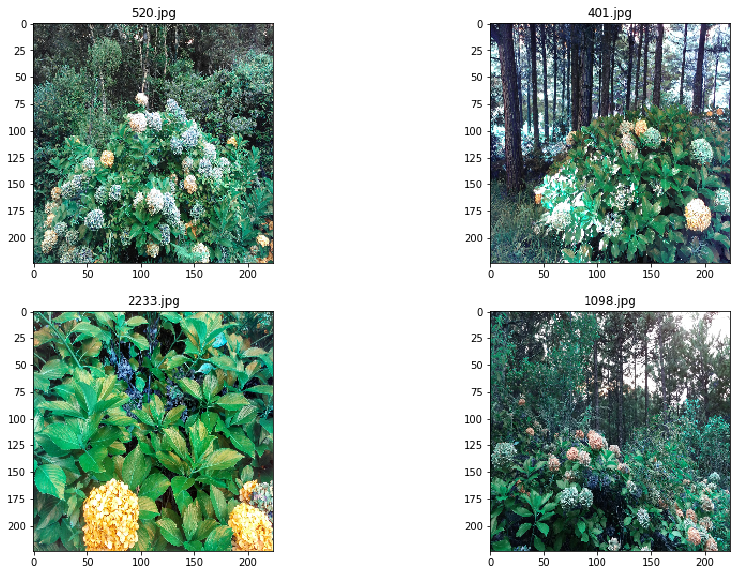

In [29]:
sample_visual_resized(4, os.path.join(TRAIN_DIR, 'invasive'), 224)

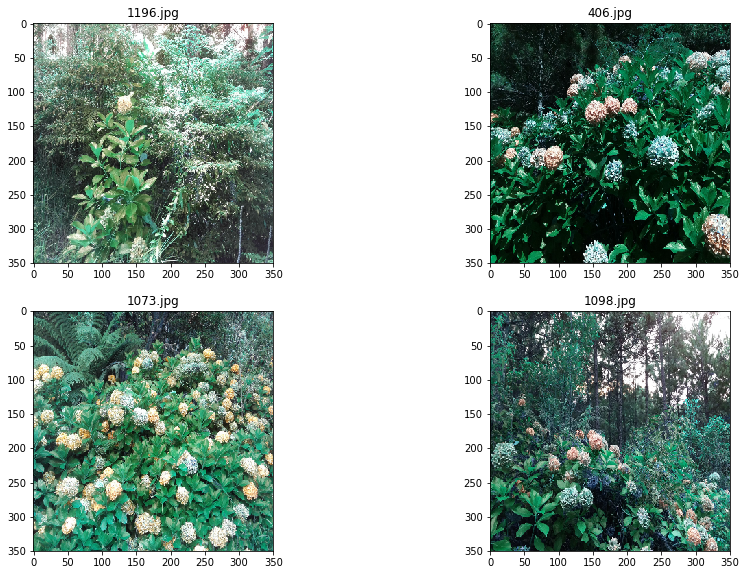

In [30]:
sample_visual_resized(4, os.path.join(TRAIN_DIR, 'invasive'), 350)

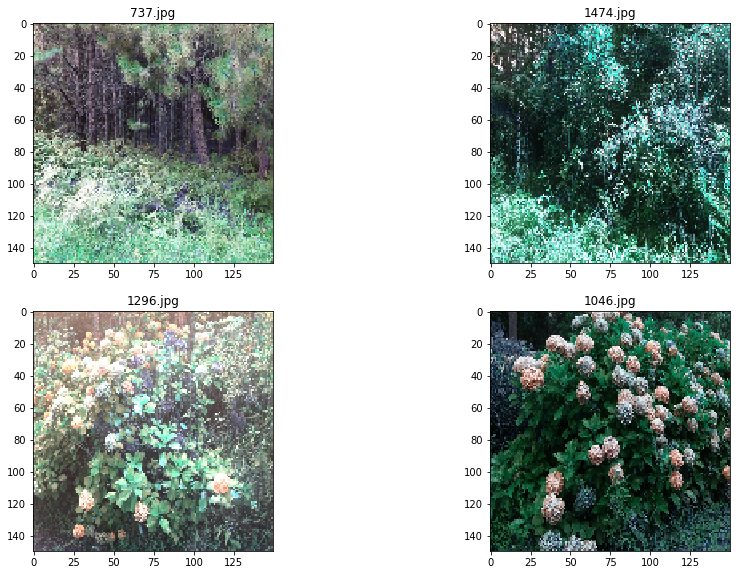

In [35]:
sample_visual_resized(4, os.path.join(TEST_DIR, ''), 150)